<a href="https://colab.research.google.com/github/Choesoohwan/CSH/blob/main/test_tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
!pip install tf-centernet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
!git clone https://github.com/niconielsen32/ObjectTracking.git
!pip install -r /content/ObjectTracking/requirements.txt

Cloning into 'ObjectTracking'...
remote: Enumerating objects: 43, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 43 (delta 1), reused 2 (delta 0), pack-reused 0
Unpacking objects: 100% (43/43), 10.84 MiB | 8.27 MiB/s, done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 KB 11.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.4/12.4 MB 100.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 83.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110474 sha256=bfe66f611a63970f7860a87ac30b84bd3e693bf3f461d6d42b73fa3615608725
  Stored in directory: /root/.cache/pip/wheels/fe/f6/cb/40331472edf4fd399b8cad02973c6acbdf26898342928327fe
  Created wheel for lap:

In [8]:
import sys
import os
from google.colab import files
import centernet

sys.path.append("/content/drive/MyDrive/Colab Notebooks/ObjectTracking")
from sort import Sort
from lib import VisTrack, show_video, create_video

import numpy as np
import PIL.Image
import cv2
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import shutil

In [10]:
from google.colab import files
files.upload()

Saving VIRAT_S_010204_05_000856_000890.mp4 to VIRAT_S_010204_05_000856_000890.mp4


{'VIRAT_S_010204_05_000856_000890.mp4': b'\x00\x00\x00 ftypisom\x00\x00\x02\x00isomiso2avc1mp41\x00\x00\x00\x08free\x00P\x01\tmdat\x00\x00\xd5\xe8e\x88\x80\x00\xa8\x00\t\x7f\xeb\xa2\xa5I\xb3\xb7\xec\x99"H\xe7oxJ\xf2\xc5\xfeU\xad|Nd\xcb:\x91\xa4\xc9t\xd4\x1e\x18\xcc\xe9:\xb1s\xd7{\xb6\xa5k?l\xfe\xd9\xa4\xbd\xa5n\xfa\x8a\x7f\'\xcb\xdf\xc8^\x9e\xd6\xba\xb1#{$\xe1\xc7D[\xe0\x17\xf5\xb830\xbdi\x00\x9f\xde"\x1b\xdeU\xea\xe9\x0fZ\xf4@\xb3\xfa\xfb\x84\xa1\xceE\x16\xae\x0c)\xce"&\x81\x032\x0f\x83#\xfb\xd0\x95ez\x08\xf9\x16l\x8b\x97=\xfe?Y\xb9\x90\xbe{\x14\xe6\x11\xf5\x1c\x88\x04\x8d\xa5\xda\x15\x0b\xb2\x04L&}\x109m\xca\xf4#K\x88\xb4\x8b\x15\xb2\xb5!-{Mf\x9b\xca ?HP\x8b6\xc3E4\x0e\x00\xcfak\xad\xb6\x8f\x1a\xd6\x98\xcd\xe9`0@\x8c\xd5\x10\x9b\xa6v\xf1\xc7\x9cy\x91\xea\x95\x12\xaek\x1f\xa1\xef\xae;\xa5\xd3E\xb9\x9fC\xfee$\x89\x88\xa9\xda_\x94E?\xea\xf5nu5\x99\xff?\xe6\x87#\xef!\x86^\xed\xf0\xed\xad\xcd\x0f\xe9\xb1\xe8tco/X~T\x82X\xf2\xbc\xfd\x80q$\xc52\x95y\xe9\r\x9c\x18\x16\xc1\xae\xdb\x9ev2\xf7\x

In [12]:
video_file='/content/drive/MyDrive/Colab Notebooks/video.mp4'
show_video(video_file)

In [13]:
obj=centernet.ObjectDetection(num_classes=80)
obj.load_weights(weights_path=None)

766861424/766861424 [==============================] - 84s 0us/step


In [14]:
from google.colab import files
files.upload()

Saving photo-1595253609635-04be6018c7f9.jfif to photo-1595253609635-04be6018c7f9.jfif


{'photo-1595253609635-04be6018c7f9.jfif': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x01\x00H\x00H\x00\x00\xff\xe2\x0cXICC_PROFILE\x00\x01\x01\x00\x00\x0cHLino\x02\x10\x00\x00mntrRGB XYZ \x07\xce\x00\x02\x00\t\x00\x06\x001\x00\x00acspMSFT\x00\x00\x00\x00IEC sRGB\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xf6\xd6\x00\x01\x00\x00\x00\x00\xd3-HP  \x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x11cprt\x00\x00\x01P\x00\x00\x003desc\x00\x00\x01\x84\x00\x00\x00lwtpt\x00\x00\x01\xf0\x00\x00\x00\x14bkpt\x00\x00\x02\x04\x00\x00\x00\x14rXYZ\x00\x00\x02\x18\x00\x00\x00\x14gXYZ\x00\x00\x02,\x00\x00\x00\x14bXYZ\x00\x00\x02@\x00\x00\x00\x14dmnd\x00\x00\x02T\x00\x00\x00pdmdd\x00\x00\x02\xc4\x00\x00\x00\x88vued\x00\x00\x03L\x00\x00\x00\x86view\x00\x00\x03\xd4\x00\x00\x00$lumi\x00\x00\x03\xf8\x00\x00\x00\x14meas\x00\x00\x04\x0c\x00\x00\x00$tech\x00\x0

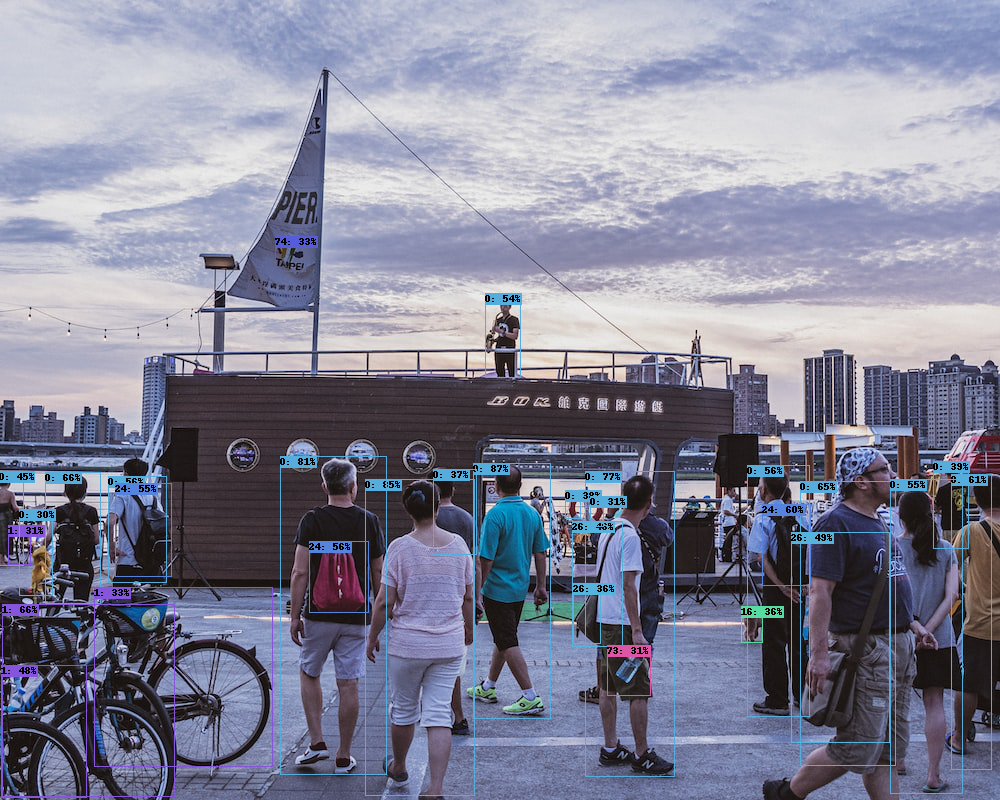

In [15]:
p_img=PIL.Image.open('/content/drive/MyDrive/Colab Notebooks/image.jpeg')
img=cv2.cvtColor(np.array(p_img), cv2.COLOR_BGR2RGB)

boxes, classes, scores = obj.predict(img)

vt=VisTrack()
vt.draw_bounding_boxes(p_img, boxes, classes, scores)

In [17]:
from sort import Sort
from lib import VisTrack, show_video, create_video

import numpy as np
import PIL.Image
import cv2
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import shutil

In [20]:
vidcap=cv2.VideoCapture(video_file)
fps = vidcap.get(cv2.CAP_PROP_FPS)
length=int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))

folder_out="Track"
if os.path.exists(folder_out):
  shutil.rmtree(folder_out)
os.makedirs(folder_out)

draw_imgs=[]

sort = Sort(max_age=1, min_hits=3, iou_threshold=0.3)

pbar=tqdm(total=length)
i=0
while True:
    ret, frame = vidcap.read()
    if not ret:
      break

    boxes, classes, scores = obj.predict(frame)
    detections_in_frame=len(boxes)
    if detections_in_frame:
      idxs=np.where(classes == 0)[0]
      boxes=boxes[idxs]
      scores=scores[idxs]
    else:
      boxes=np.empty((0, 5))

    dets=np.hstack((boxes, scores[:,np.newaxis]))
    res=sort.update(dets)

    boxes_track=res[:,:-1]
    boces_ids=res[:,-1].astype(int)

    p_frame=PIL.Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    if detections_in_frame:
      p_frame=vt.draw_bounding_boxes(p_frame, boxes_track, boces_ids, scores)
    p_frame.save(os.path.join(folder_out, f"{i:03d}.png"))

    i+=1
    pbar.update(1)



  0%|          | 0/584 [00:00<?, ?it/s]

In [21]:
track_video_file='tracking.mp4'
create_video(frames_patten='Track/%03d.png', video_file=track_video_file, framerate=fps)

In [22]:
files.download(track_video_file)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [23]:
show_video(track_video_file)